In [6]:
import numpy as np
import pandas as pd
import chart_studio.plotly as py 
import seaborn as sns 
import plotly.express as px 
import cufflinks as cf
%matplotlib inline 

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 
init_notebook_mode(connected=True)
cf.go_offline()

# Basics

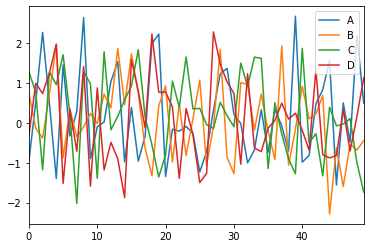

In [9]:
arr_1 = np.random.randn(50, 4)
df_1 = pd.DataFrame(arr_1, columns = ['A','B','C','D'])
df_1.plot()

In [10]:
df_1.iplot()

# Line plots

In [13]:
import plotly.graph_objects as go
df_stocks = px.data.stocks() #get stock data 
px.line(df_stocks,x='date', y='GOOG', labels = {'x':'Date', 'y':'Price'}, title='GOOG stock data')
# plot a line chart 
# argument 1 - dataframe from where we want to plot 
#x = var on x axis 
#y = var on y axis 
#labels = dictionary with x and y as keys and the text as values 

In [15]:
px.line(df_stocks,x='date', y=['GOOG','AAPL'], labels = {'x':'Date', 'y':'Price'}, title='AAPL vs GOOG')
# we can pass list of columns to plot multiple columns 

In [22]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_stocks['date'], y=df_stocks['AAPL'], mode='lines', name='Apple'))
#simple scatter plot with lines connnecting the data points 
fig.add_trace(go.Scatter(x= df_stocks['date'], y=df_stocks['AMZN'], mode='lines+markers', name='Amazon'))
#scatter plot with lines and dots connecting the points 
fig.add_trace(go.Scatter(x= df_stocks['date'], y=df_stocks['GOOG'], mode='lines+markers', name='Google',
             line = dict(color='firebrick', width=2, dash='dashdot')))
#scatter plot with lines and dots connecting the points but this time we have passed custom arguments for the line as a dict
fig.update_layout(title='Stock price data 2018 to 2020', xaxis_title='Price', yaxis_title='Date')
#adding title, xlabel and ylabel to data 
fig.update_layout(
    xaxis = dict(showline=True, showgrid=False, showticklabels=True,linecolor='rgb(204,204,204)',linewidth=2, 
                ticks='outside', tickfont = dict(family='Arial',size=12, color='rgb(82,82,82)')), 
    yaxis = dict(showgrid=False, zeroline=False, showline=False, showticklabels=False),
    autosize=False, margin = dict(autoexpand=False, l=100, r=20, t=110),
    showlegend=False, plot_bgcolor='White'
)

``` 
Similar to 
fig = plt.figure()
fig.add_axis().scatter() ....
```

# Bar charts

In [23]:
df_us = px.data.gapminder().query("country == 'United States'")
px.bar(df_us, x='year', y='pop')

In [24]:
df_tips = px.data.tips()
px.bar(df_tips, x='day', y='tip', color='sex', title='Tips by sex on each day',
       labels={'tip':'Tip Amount', 'day':'day of the week'})

In [25]:
px.bar(df_tips, x='sex', y='total_bill', color='smoker', barmode='group')

In [29]:
df_europe = px.data.gapminder().query("continent=='Europe' and year==2007 and pop>2.e6")
fig = px.bar(df_europe, y='pop', x='country', text='pop', color='country')
fig.update_traces(texttemplate='%{text:.2s}',textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.update_layout(xaxis_tickangle=-45)
fig

# scatter plots

In [30]:
df_iris = px.data.iris()
px.scatter(df_iris, x='sepal_width', y='sepal_length', color='species', size='petal_length', hover_data=['petal_width'])

In [32]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_iris['sepal_width'], y=df_iris['sepal_length'], mode='markers', 
                         marker_color=df_iris['sepal_width'], text=df_iris['species'], 
                         marker=dict(showscale=True)))
fig.update_traces(marker_line_width=2,marker_size=10)

In [34]:
fig = go.Figure(data=go.Scattergl(x = np.random.randn(100000), y=np.random.randn(100000), mode='markers', 
                                 marker = dict(color=np.random.randn(100000), colorscale='Viridis', line_width=1)))
fig

# Pie Chart 

In [46]:
df_asia = px.data.gapminder().query("year==2007").query("continent=='Asia'")
px.pie(df_asia, values='pop', names='country', title='Population of Asian continent', 
       color_discrete_sequence=px.colors.sequential.RdBu)

colors = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = go.Figure(data=[go.Pie(labels=['Water','Grass','Normal','Psychic', 'Fire', 'Ground'], 
                       values=[110,90,80,80,70,60])])

fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  textinfo='label+percent', pull=[0.1, 0, 0.2, 0, 0, 0],
                  marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)))

# Histogram

In [49]:
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 + dice_2 
fig = px.histogram(dice_sum, nbins=11, labels={'value':'Dice Roll'}, title='5000 dice roll histogram',marginal='violin',
                  color_discrete_sequence=['green'])
fig.update_layout(xaxis_title_text='Dice Roll', 
                 yaxis_title_text='Dice Sum',
                 bargap=0.2, showlegend=False)
fig

In [51]:
px.histogram(df_tips, x='total_bill', color='sex')

# Boxplot

In [52]:
px.box(df_tips,x='sex', y='tip', points='all')

In [53]:
px.box(df_tips, x='day', y='tip', color='sex')

In [54]:
fig = go.Figure()
# Show all points, spread them so they don't overlap and change whisker width
fig.add_trace(go.Box(y=df_stocks.GOOG, boxpoints='all', name='Google',
                    fillcolor='blue', jitter=0.5, whiskerwidth=0.2))
fig.add_trace(go.Box(y=df_stocks.AAPL, boxpoints='all', name='Apple',
                    fillcolor='red', jitter=0.5, whiskerwidth=0.2))
# Change background / grid colors
fig.update_layout(title='Google vs. Apple', 
                  yaxis=dict(gridcolor='rgb(255, 255, 255)',
                 gridwidth=3),
                 paper_bgcolor='rgb(243, 243, 243)',
                 plot_bgcolor='rgb(243, 243, 243)')

# Violin plot

In [55]:
# Violin Plot is a combination of the boxplot and KDE
# While a box plot corresponds to data points, the violin plot uses the KDE estimation
# of the data points
df_tips = px.data.tips()
px.violin(df_tips, y="total_bill", box=True, points='all')

# Multiple plots
px.violin(df_tips, y="tip", x="smoker", color="sex", box=True, points="all",
          hover_data=df_tips.columns)

# Morph left and right sides based on if the customer smokes
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'Yes' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'Yes' ],
                        legendgroup='Yes', scalegroup='Yes', name='Yes',
                        side='negative',
                        line_color='blue'))
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'No' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'No' ],
                        legendgroup='Yes', scalegroup='Yes', name='No',
                        side='positive',
                        line_color='red'))

In [56]:
flights = sns.load_dataset("flights")
flights

# You can set bins with nbinsx and nbinsy
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         color_continuous_scale="Viridis")
fig

# You can add histograms
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         marginal_x="histogram", marginal_y="histogram")
fig

In [57]:
fig = px.scatter_3d(flights, x='year', y='month', z='passengers', color='year',
                   opacity=0.7, width=800, height=400)
fig

In [58]:
fig = px.line_3d(flights, x='year', y='month', z='passengers', color='year')
fig

In [59]:
fig = px.scatter_matrix(flights, color='month')
fig

In [60]:
df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations="iso_alpha",
                     color="continent", # which column to use to set the color of markers
                     hover_name="country", # column added to hover information
                     size="pop", # size of markers
                     projection="orthographic")
fig

In [61]:
from urllib.request import urlopen
# Used to decode JSON data
import json
# Grab US county geometry data
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Grab unemployment data based on each counties Federal Information Processing number
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig

In [63]:
df_wind = px.data.wind()
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength",
                size="frequency", symbol="strength")

# Data can also be plotted using lines radially
# A template makes the data easier to see
px.line_polar(df_wind, r="frequency", theta="direction", color="strength",
                line_close=True, template="plotly_dark", width=800, height=400)

In [64]:
df_exp = px.data.experiment()
px.scatter_ternary(df_exp, a="experiment_1", b="experiment_2", 
                   c='experiment_3', hover_name="group", color="gender")

In [65]:
df_tips = px.data.tips()
px.scatter(df_tips, x="total_bill", y="tip", color="smoker", facet_col="sex")

# We can line up data in rows and columns
px.histogram(df_tips, x="total_bill", y="tip", color="sex", facet_row="time", facet_col="day",
       category_orders={"day": ["Thur", "Fri", "Sat", "Sun"], "time": ["Lunch", "Dinner"]})

# This dataframe provides scores for different students based on the level
# of attention they could provide during testing
att_df = sns.load_dataset("attention")
fig = px.line(att_df, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')
fig

In [66]:
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x="gdpPercap", y="lifeExp", animation_frame="year", 
           animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

# Watch as bars chart population changes
px.bar(df_cnt, x="continent", y="pop", color="continent",
  animation_frame="year", animation_group="country", range_y=[0,4000000000])